In [1]:
import numpy as np

In [2]:
M_e = 5.9742E25
G = 6.673E-11
R_e = 6400 * 1000
delta_r = 7500

In [3]:
def calc_g(r):
    return G*(M_e/r)


In [4]:
p_sea_level = calc_g(R_e)
p_75 = calc_g((R_e+delta_r))


In [5]:
delta_g = p_75 - p_sea_level

In [6]:
print("Sea level: {:.3E}".format(p_sea_level))
print("75k up: {:.3E}".format(p_75))
print("delta_g: {:.3E}".format(delta_g))

Sea level: 6.229E+08
75k up: 6.222E+08
delta_g: -7.291E+05


Finite difference test

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
def f(x):
    return np.sin(x)

In [ ]:
# interval

a, b = 0, 2 * np.pi  # interval
N = 100              # number of grid points
x = np.linspace(a, b, N)
h = x[1] - x[0]      # uniform spacing

In [ ]:
y = f(x)

In [ ]:
dfdx = np.zeros_like(y)
dfdx[1:-1] = (y[2:] - y[:-2]) / (2 * h)

In [ ]:
d2fdx2 = np.zeros_like(y)
d2fdx2[1:-1] = (y[2:] - 2*y[1:-1] + y[:-2]) / (h**2)

In [ ]:
dfdx_true = np.cos(x)
d2fdx2_true = -np.sin(x)

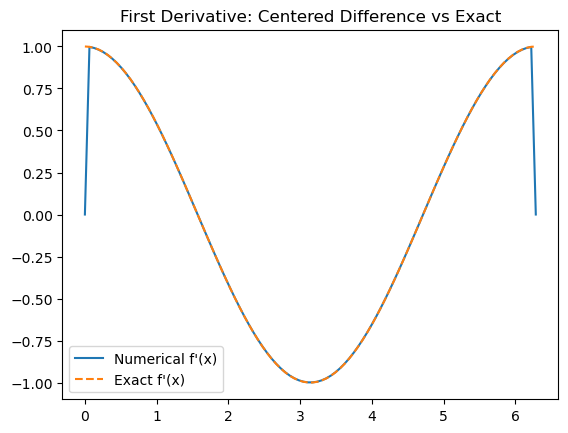

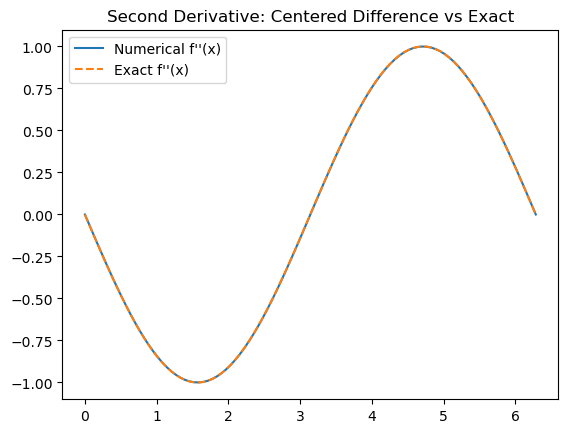

In [ ]:
plt.plot(x, dfdx, label="Numerical f'(x)")
plt.plot(x, dfdx_true, '--', label="Exact f'(x)")
plt.legend()
plt.title("First Derivative: Centered Difference vs Exact")
plt.show()

plt.plot(x, d2fdx2, label="Numerical f''(x)")
plt.plot(x, d2fdx2_true, '--', label="Exact f''(x)")
plt.legend()
plt.title("Second Derivative: Centered Difference vs Exact")
plt.show()

In [1]:
import xarray as xr
import numpy as np
import metpy.calc as mpcalc
from metpy.units import units
from pyproj import Proj, Transformer
import cartopy.crs as ccrs
import matplotlib.pyplot as plt


In [21]:
# Load CMIP6 geopotential height, winds, and temperature (example dataset)
#ds = xr.open_dataset("/Users/ryaneagan/Downloads/met_test_data_500hpa.nc")  # Replace with actual dataset

#ds_u = xr.open_dataset("/Users/ryaneagan/Downloads/cmip5_test/ua_day_GFDL-ESM2M_rcp26_r1i1p1_20710101-20751231.nc")
#ds_v = xr.open_dataset("/Users/ryaneagan/Downloads/cmip5_test/va_day_GFDL-ESM2M_rcp26_r1i1p1_20710101-20751231.nc")

ds = xr.open_dataset("/Users/ryaneagan/Downloads/cmip5_test/psl_day_GFDL-ESM4_ssp126_r1i1p1f1_gr1_20550101-20741231.nc")

In [22]:
ds

<xarray.Dataset> Size: 2GB
Dimensions:    (bnds: 2, lat: 180, lon: 288, time: 7300)
Coordinates:
  * bnds       (bnds) float64 16B 1.0 2.0
  * lat        (lat) float64 1kB -89.5 -88.5 -87.5 -86.5 ... 86.5 87.5 88.5 89.5
  * lon        (lon) float64 2kB 0.625 1.875 3.125 4.375 ... 356.9 358.1 359.4
  * time       (time) object 58kB 2055-01-01 12:00:00 ... 2074-12-31 12:00:00
Data variables:
    lat_bnds   (lat, bnds) float64 3kB ...
    lon_bnds   (lon, bnds) float64 5kB ...
    psl        (time, lat, lon) float32 2GB ...
    time_bnds  (time, bnds) object 117kB ...
Attributes: (12/46)
    external_variables:     areacella
    history:                File was processed by fremetar (GFDL analog of CM...
    table_id:               day
    activity_id:            ScenarioMIP
    branch_method:          standard
    branch_time_in_child:   60225.0
    ...                     ...
    title:                  NOAA GFDL GFDL-ESM4 model output prepared for CMI...
    tracking_id:            hdl:21.14100/27492cb3-3aee-467f-aefd-e42d73b2f39c
    variable_id:            psl
    variant_info:           N/A
    references:             see further_info_url attribute
    variant_label:          r1i1p1f1

In [9]:
#ds_u["va"] = ds_v["va"]
ds = ds_u

In [11]:
ds

<xarray.Dataset> Size: 2GB
Dimensions:     (plev: 8, time: 1825, lat: 90, lon: 144, bnds: 2)
Coordinates:
  * plev        (plev) float64 64B 1e+05 8.5e+04 7e+04 ... 1e+04 5e+03 1e+03
  * lat         (lat) float64 720B -89.49 -87.98 -85.96 ... 85.96 87.98 89.49
  * lon         (lon) float64 1kB 1.25 3.75 6.25 8.75 ... 353.8 356.2 358.8
  * bnds        (bnds) float64 16B 1.0 2.0
  * time        (time) object 15kB 2071-01-01 12:00:00 ... 2075-12-31 12:00:00
Data variables:
    average_DT  (time) timedelta64[ns] 15kB ...
    average_T1  (time) datetime64[ns] 15kB ...
    average_T2  (time) datetime64[ns] 15kB ...
    time_bnds   (time, bnds) object 29kB ...
    ua          (time, plev, lat, lon) float32 757MB ...
    lat_bnds    (lat, bnds) float64 1kB ...
    lon_bnds    (lon, bnds) float64 2kB ...
    va          (time, plev, lat, lon) float32 757MB ...
Attributes: (12/27)
    title:                  NOAA GFDL GFDL-ESM2M, RCP2.6 (run 1) experiment o...
    institute_id:           NOAA GFDL
    source:                 GFDL-ESM2M 2010 ocean: MOM4 (MOM4p1_x1_Z50_cCM2M,...
    contact:                gfdl.climate.model.info@noaa.gov
    project_id:             CMIP5
    table_id:               Table day (31 Jan 2011)
    ...                     ...
    parent_experiment_id:   historical
    physics_version:        1
    product:                output1
    institution:            NOAA GFDL(201 Forrestal Rd, Princeton, NJ, 08540)
    history:                File was processed by fremetar (GFDL analog of CM...
    parent_experiment_rip:  r1i1p1

In [12]:
# Define the polar stereographic projection for the South Pole
south_pole_proj = Proj(proj='stere', lat_ts=-71, lat_0=-90, lon_0=0, ellps='WGS84')

# Convert lat/lon to 2D arrays
lats = ds['lat'].values
lons = ds['lon'].values

# If 1D, make 2D meshgrid
lon2d, lat2d = np.meshgrid(lons, lats)

# Transform to x, y (in meters)
x, y = south_pole_proj(lon2d, lat2d)

# Add x and y as new coordinates
ds = ds.assign_coords({'x': (('lat', 'lon'), x),
                       'y': (('lat', 'lon'), y)})

In [13]:
ds

<xarray.Dataset> Size: 2GB
Dimensions:     (plev: 8, time: 1825, lat: 90, lon: 144, bnds: 2)
Coordinates:
  * plev        (plev) float64 64B 1e+05 8.5e+04 7e+04 ... 1e+04 5e+03 1e+03
  * lat         (lat) float64 720B -89.49 -87.98 -85.96 ... 85.96 87.98 89.49
  * lon         (lon) float64 1kB 1.25 3.75 6.25 8.75 ... 353.8 356.2 358.8
  * bnds        (bnds) float64 16B 1.0 2.0
  * time        (time) object 15kB 2071-01-01 12:00:00 ... 2075-12-31 12:00:00
    x           (lat, lon) float64 104kB 1.198e+03 3.593e+03 ... -6.074e+07
    y           (lat, lon) float64 104kB 5.492e+04 5.482e+04 ... 2.783e+09
Data variables:
    average_DT  (time) timedelta64[ns] 15kB ...
    average_T1  (time) datetime64[ns] 15kB ...
    average_T2  (time) datetime64[ns] 15kB ...
    time_bnds   (time, bnds) object 29kB ...
    ua          (time, plev, lat, lon) float32 757MB ...
    lat_bnds    (lat, bnds) float64 1kB ...
    lon_bnds    (lon, bnds) float64 2kB ...
    va          (time, plev, lat, lon) float32 757MB ...
Attributes: (12/27)
    title:                  NOAA GFDL GFDL-ESM2M, RCP2.6 (run 1) experiment o...
    institute_id:           NOAA GFDL
    source:                 GFDL-ESM2M 2010 ocean: MOM4 (MOM4p1_x1_Z50_cCM2M,...
    contact:                gfdl.climate.model.info@noaa.gov
    project_id:             CMIP5
    table_id:               Table day (31 Jan 2011)
    ...                     ...
    parent_experiment_id:   historical
    physics_version:        1
    product:                output1
    institution:            NOAA GFDL(201 Forrestal Rd, Princeton, NJ, 08540)
    history:                File was processed by fremetar (GFDL analog of CM...
    parent_experiment_rip:  r1i1p1

In [14]:
ds['plev']

<xarray.DataArray 'plev' (plev: 8)> Size: 64B
array([100000.,  85000.,  70000.,  50000.,  25000.,  10000.,   5000.,   1000.])
Coordinates:
  * plev     (plev) float64 64B 1e+05 8.5e+04 7e+04 5e+04 ... 1e+04 5e+03 1e+03
Attributes:
    units:          Pa
    long_name:      pressure
    axis:           Z
    positive:       down
    standard_name:  air_pressure

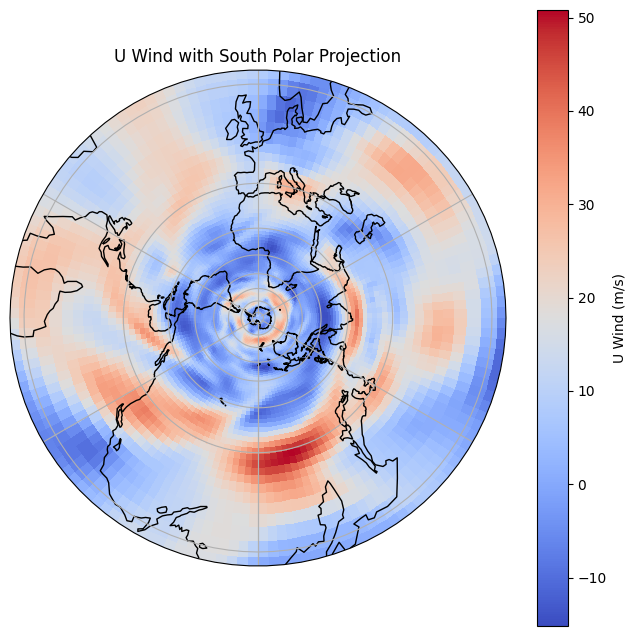

In [19]:
# Choose a variable and time slice to plot
# South Polar Stereographic CRS
proj = ccrs.SouthPolarStereo()

data = ds['ua'][0, 3, :, :]  # Example: temperature at surface or level 0

fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': proj})

# Use `transform` to indicate original CRS (PlateCarree)
pc = ax.pcolormesh(lons, lats, data, transform=ccrs.PlateCarree(), cmap='coolwarm')


ax.coastlines()
ax.gridlines()
plt.colorbar(pc, ax=ax, orientation='vertical', label='U Wind (m/s)')
plt.title("U Wind with South Polar Projection")
plt.show()

/Users/ryaneagan/opt/anaconda3/envs/met2/lib/python3.11/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'color'
  result = super().contour(*args, **kwargs)


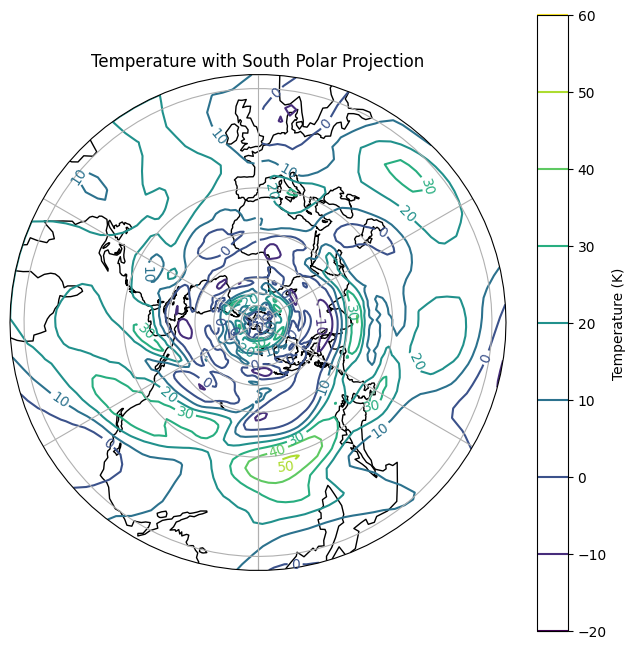

In [20]:
# Choose a variable and time slice to plot
# South Polar Stereographic CRS
proj = ccrs.SouthPolarStereo()

data = ds['ua'][0, 3, :, :]  # Example: temperature at surface or level 0

fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': proj})

pc = ax.contour(lons, lats, data, transform=ccrs.PlateCarree(), color='b')
ax.clabel(pc)
ax.coastlines()
ax.gridlines()
plt.colorbar(pc, ax=ax, orientation='vertical', label='Temperature (K)')
plt.title("Temperature with South Polar Projection")
plt.show()

In [9]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

data = ds['z'][0, 0, :, :]  # Example: temperature at surface or level 0
# Geopotential to geopotential height
g = 9.80665
z_500 = data = ds['z'][0, 0, :, :] / g


In [10]:
lats = ds['latitude'].values
lons = ds['longitude'].values
lon2d, lat2d = np.meshgrid(lons, lats)

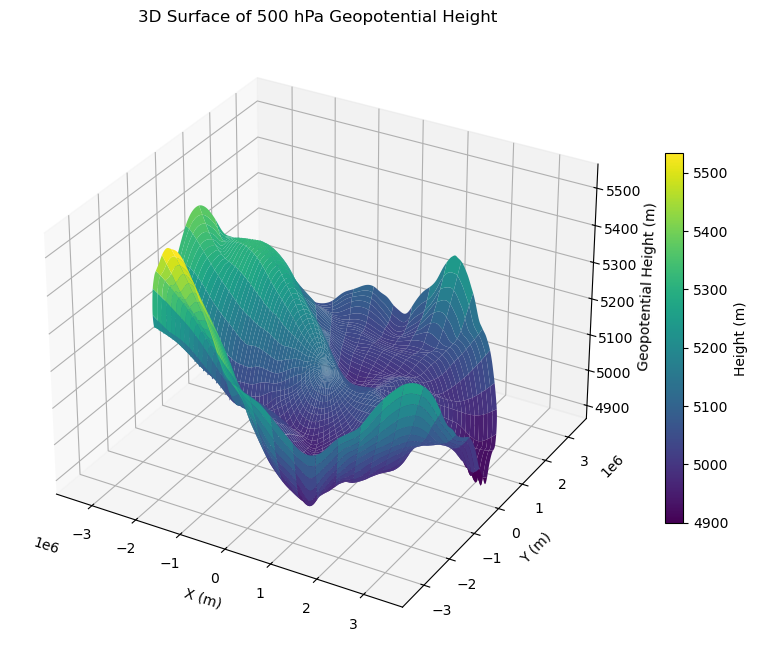

In [11]:
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# 3D Surface plot
surf = ax.plot_surface(x, y, z_500, cmap='viridis', edgecolor='none')

ax.set_xlabel("X (m)")
ax.set_ylabel("Y (m)")
ax.set_zlabel("Geopotential Height (m)")
ax.set_title("3D Surface of 500 hPa Geopotential Height")

fig.colorbar(surf, ax=ax, shrink=0.6, label='Height (m)')
plt.show()

In [ ]:
import plotly.graph_objects as go

# Assuming you've already projected lat/lon to x/y in meters
z_vals = z_500.values  # shape (lat, lon)

fig = go.Figure(data=[go.Surface(z=z_vals, x=x, y=y, colorscale='Viridis')])
fig.update_layout(
    title="500 hPa Geopotential Height",
    scene=dict(
        xaxis_title="X (m)",
        yaxis_title="Y (m)",
        zaxis_title="Height (m)"
    )
)

fig.show()

In [ ]:
import cartopy.feature as cfeature
import cartopy.io.shapereader as shpreader

shapefile_path = shpreader.natural_earth(resolution='110m', category='physical', name='coastline')

coastline = cfeature.NaturalEarthFeature('physical', 'coastline', '110m')
reader = shpreader.Reader(shapefile_path)
geoms = list(reader.geometries())

from pyproj import Proj

proj = Proj(proj='stere', lat_ts=-71, lat_0=-90, lon_0=0)
coastline_traces = []

for geom in geoms:
    if geom.geom_type == 'LineString':
        lon, lat = geom.xy
        x, y = proj(lon, lat)
        x = np.array(x)
        y = np.array(y)
        coastline_traces.append((x, y))
    elif geom.geom_type == 'MultiLineString':
        for line in geom:
            lon, lat = line.xy
            x, y = proj(lon, lat)
            x = np.array(x)
            y = np.array(y)
            coastline_traces.append((x, y))

import plotly.graph_objects as go

# Main surface
surface = go.Surface(z=z_500, x=x, y=y, colorscale='Viridis', name='Geopotential Height')

# Coastline traces on z = 0
coastline_lines = [
    go.Scatter3d(
        x=x_c,
        y=y_c,
        z=[z_500.min().item()] * len(x_c),  # Flat bottom
        mode='lines',
        line=dict(color='black', width=2),
        name='Coastline'
    ) for x_c, y_c in coastline_traces
]

fig = go.Figure(data=[surface] + coastline_lines)

fig.update_layout(
    scene=dict(
        xaxis_title='X (m)',
        yaxis_title='Y (m)',
        zaxis_title='Height (m)'
    ),
    title="500 hPa Geopotential Height with Coastlines",
)

fig.show()

In [ ]:
from pyproj import Proj

south_pole_proj = Proj(proj='stere', lat_ts=-71, lat_0=-90, lon_0=0, ellps='WGS84')
x, y = south_pole_proj(lon2d, lat2d)

In [ ]:
# weights for lon
weights = np.cos(np.deg2rad(ds.latitude))
weights.name='weights'

# Select variables
Z = ds['z']  # Geopotential height [m]
U = ds['u']  # Zonal wind [m/s]
V = ds['v']  # Meridional wind [m/s]
T = ds['t']  # Temperature [K]
lat = ds['latitude']
lon = ds['longitude']
lev = ds['pressure_level']  # Pressure levels (Pa)
time = ds['valid_time']

Streamfunction $ \psi $ from geopotential height Z $

$$ \psi=\frac{p}{f_{0}}Z $$

In [12]:
# Define constants
omega = 7.2921e-5  # Earth's rotation rate [s^-1]
R = 287.0  # Gas constant for dry air [J/(kg*K)]
g = 9.81  # Gravity [m/s^2]
#f0 = 2 * omega * np.sin(np.deg2rad(lat))  # Coriolis parameter

lat_rad = np.deg2rad(ds['latitude'])
f = 2 * omega * np.sin(lat_rad)

# Expand f to 2D
f_2d = f.broadcast_like(ds['z'])

# Compute streamfunction ψ
#psi = (Z / g) * (lev / f0)

psi = ds['z'] / f_2d
ds['psi'] = psi

In [ ]:
import numpy as np

# Assume psi is 2D: psi(latitude, longitude)
psi_vals = ds['psi']
lat = ds['latitude'].values
lon = ds['longitude'].values

# Convert lat/lon spacing to meters
R = 6.371e6
deg2rad = np.pi / 180
dlat = np.gradient(lat) * deg2rad * R
dlon = np.gradient(lon) * deg2rad * R * np.cos(np.deg2rad(lat[:, np.newaxis]))

# Compute partials
dpsi_dlat, dpsi_dlon = np.gradient(psi_vals, dlat, axis=0
                                   ), np.gradient(psi_vals, axis=1) / dlon

# Now compute geostrophic winds
u_g = -dpsi_dlat  # zonal
v_g = dpsi_dlon   # meridional

ValueError: when 1d, distances must match the length of the corresponding dimension

### Compute QGPV using finite difference

QGPV in pressure coordinates:

$$ q = \nabla^2\psi+f+\frac{\partial}{\partial p}(\frac{f_{0}^2}{\sigma}\frac{\partial\psi}{\partial p})

In [ ]:
dx = np.gradient(lon) * (np.pi / 180) * 6371000 #* np.cos(np.deg2rad(lat))  # Grid spacing [m]
dy = np.gradient(lat) * (np.pi / 180) * 6371000  # Grid spacing [m]

# Compute second derivatives
d2psi_dx2 = (psi.shift(lon=-1) - 2 * psi + psi.shift(lon=1)) / dx**2
d2psi_dy2 = (psi.shift(lat=-1) - 2 * psi + psi.shift(lat=1)) / dy**2

# Compute Laplacian
laplacian_psi = d2psi_dx2 + d2psi_dy2

### Compute the vertical derivative term

$$ \frac{\partial}{\partial p}(\frac{f_{0}^2}{\sigma}\frac{\partial\psi}{\partial p}) $$

where

$$ \sigma = -\frac{RT}{p}(\frac{\partial \ln(\theta)}{\partial p}) $$

In [ ]:
# Compute static stability parameter σ
theta = T * (100000 / lev) ** (R / 1004)  # Potential temperature [K]
dtheta_dp = np.gradient(np.log(theta), lev, axis=0)
sigma = -(R * T / lev) * dtheta_dp

# Compute vertical derivative term
dpsi_dp = np.gradient(psi, lev, axis=0)
d2psi_dp2 = np.gradient(dpsi_dp, lev, axis=0)

QGPV_vertical = np.gradient((f0**2 / sigma) * dpsi_dp, lev, axis=0)

### Compute QGPV

$$ q=\nabla^2\psi + f + QGPV_{vertical} $$

In [ ]:
# Compute full QGPV
QGPV = laplacian_psi + f0 + QGPV_vertical